#Style Transfer Using GAN
* --Seetharam Rao

### Importing the Library

In [1]:
'''
numpy - 1.19.2
tensorflow - 2.4.1
matplotlib - 3.3.2
skimage - 0.17.2'''
!pip install numpy==1.19.2
!pip install tensorflow-gpu==2.4.1
!pip install matplotlib==3.3.2
!pip install scikit-image==0.17.2
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-rl6gmg_k
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-rl6gmg_k
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.081621e0e3aae9584686cd4bf65c7fa00b0001d3c_-cp37-none-any.whl size=149185 sha256=13d04dbb69f8af64e5f5bdfb84dd11474fc48195530b4917a821c421a742983f
  Stored in directory: /tmp/pip-ephem-wheel-cache-7vij9ikn/wheels/eb/1b/35/fce87697be00d2fc63e0b4b395b0d9c7e391a10e98d9a0d97f
Successfully built tensorflow-docs


### Initialising the required packages

In [2]:
#Importing necessary Libraries.
import tensorflow as tf
import matplotlib.pyplot as plt
import glob # to find certain directories
import imageio
from IPython import display
from skimage.transform import resize
import numpy as np
import os # to access the folders and files
from keras.utils.vis_utils import plot_model
import cv2
from scipy import ndimage

### Data preparation
### Downloading the Dataset

#### Extracting the dataset

In [4]:
!unrar x MRI+T1_T2+Dataset.RAR

Tr1 = glob.glob('Tr1/TrainT1/Image*.png')
Tr1 = sorted(Tr1)
Tr2 = glob.glob('Tr2/TrainT2/Image*.png')
Tr2 = sorted(Tr2)


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from MRI+T1_T2+Dataset.RAR

Creating    Tr1                                                       OK
Extracting  Tr1/.DS_Store                                                  0%  OK 
Creating    Tr1/TrainT1                                               OK
Extracting  Tr1/TrainT1/Image #10.png                                      1%  OK 
Extracting  Tr1/TrainT1/Image #11.png                                      2%  OK 
Extracting  Tr1/TrainT1/Image #12.png                                      3%  OK 
Extracting  Tr1/TrainT1/Image #13.png                                      4%  OK 
Extracting  Tr1/TrainT1/Image #14.png                                      5%  OK 
Extracting  Tr1/TrainT1/Image #15.png                                      6%  OK 
Extracting  Tr1/TrainT1/Image #16.png                                      7%  OK 
Extracting

### Dataset image property

In [5]:
image = imageio.imread(Tr1[1])
print(f"Total no of Tr1 image :- {len(Tr1)}")
print(f"Total no of Tr2 image :- {len(Tr2)}")
print(f"Image shape:- {image.shape}")

Total no of Tr1 image :- 43
Total no of Tr2 image :- 46
Image shape:- (217, 181)


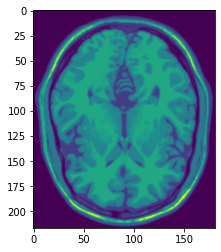

In [6]:
plt.imshow(image)

### Data processing 



In [7]:
BATCH_SIZE = 32
RE_SIZE = 256

In [8]:
def read_image(path):
  image_tr = np.zeros((len(path)*2,RE_SIZE,RE_SIZE))
  cnt = 0
  for pth in path:
    image = imageio.imread(pth)
    image = cv2.copyMakeBorder(image,0,0,18,18,borderType=cv2.BORDER_CONSTANT)
    image = cv2.resize(image,(RE_SIZE,RE_SIZE))
    image_tr[cnt,:,:] = image
    image_tr[cnt+1,:,:] = cv2.flip(image,1)
    # image_tr[cnt+2,:,:] = cv2.resize(ndimage.rotate(image,5),(RE_SIZE,RE_SIZE))
    # image_tr[cnt+3,:,:] = cv2.flip(image_tr[cnt+2,:,:],1)
    # image_tr[cnt+4,:,:] = cv2.resize(ndimage.rotate(image,-2),(RE_SIZE,RE_SIZE))
    # image_tr[cnt+5,:,:] = cv2.flip(image_tr[cnt+4,:,:],1)
    # img = cv2.resize(image, (RE_SIZE-36,RE_SIZE), interpolation = cv2.INTER_AREA)
    # image_tr[cnt+6,:,:] = cv2.copyMakeBorder(img,0,0,18,18,borderType=cv2.BORDER_CONSTANT)
    # img = cv2.resize(image, (RE_SIZE,RE_SIZE-36), interpolation = cv2.INTER_AREA)
    # image_tr[cnt+7,:,:] = cv2.copyMakeBorder(img,18,18,0,0,borderType=cv2.BORDER_CONSTANT)
    cnt += 2
  return image_tr

In [9]:
image_tr1 = read_image(Tr1)
image_tr2 = read_image(Tr2)

In [10]:
print(f"size of TR1: {image_tr1.shape}, TR2: {image_tr2.shape}")

size of TR1: (86, 256, 256), TR2: (92, 256, 256)


### Data normalization 

In [11]:
image_tr1 = (image_tr1/127.5)-1.0
image_tr2 = (image_tr2/127.5)-1.0

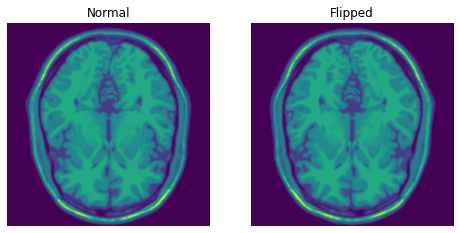

In [12]:
title = ["Normal","Flipped"]
plt.figure(figsize=(8, 10))
for i in range(2):
  image = image_tr1[i,:,:]
  ax = plt.subplot(1, 2, i + 1)
  plt.title(title[i])
  plt.imshow(image)
  plt.axis("off")


#### Normalized image pixel value range

In [13]:
print(f"Min value:- {image_tr1[1].min()}, \nMax value:- {image_tr1[1].max()}")

Min value:- -1.0, 
Max value:- 0.9843137254901961


### Packing image into Tensor Dataset
* packing into batchs
* shuffling



In [14]:
image_tr1 = image_tr1.reshape(image_tr1.shape[0], RE_SIZE, RE_SIZE, 1).astype('float32')
image_tr1 = tf.data.Dataset.from_tensor_slices(image_tr1).shuffle(image_tr1.shape[0],seed=42).batch(BATCH_SIZE)

image_tr2 = image_tr2.reshape(image_tr2.shape[0], RE_SIZE, RE_SIZE, 1).astype('float32')
image_tr2 = tf.data.Dataset.from_tensor_slices(image_tr2).shuffle(image_tr2.shape[0],seed=42).batch(BATCH_SIZE)

### Tr1 Dataset

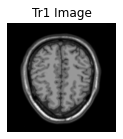

In [15]:
sample = next(iter(image_tr1))
plt.figure(figsize=(2, 2))
plt.imshow(sample[0].numpy()[:, :, 0], cmap='gray')
plt.title("Tr1 Image")
plt.axis('off')
plt.show()

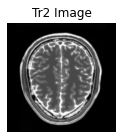

In [16]:
sample = next(iter(image_tr2))
plt.figure(figsize=(2, 2))
plt.imshow(sample[0].numpy()[:, :, 0], cmap='gray')
plt.title("Tr2 Image")
plt.axis('off')
plt.show()

## Model Building
* Instance Normalization
* Downsampling, Upsampling and Unet
* Generator Building using Unet
* Discriminator Building

#### Instance Normalization

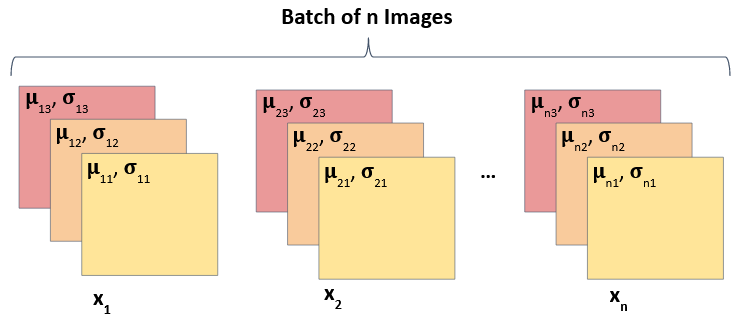

In [17]:
class InstanceNormalization(tf.keras.layers.Layer):
  def __init__(self, epsilon=1e-5):
    #calling parent's init
    super(InstanceNormalization,self).__init__()
    self.epsilon = epsilon
  
  def build(self, input_shape):
    self.scale = self.add_weight(
        name='scale',
        shape=input_shape[-1:],
        initializer = tf.random_normal_initializer(1.,0.02),
        trainable=True)
    self.offset = self.add_weight(
        name='offset',
        shape=input_shape[-1:],
        initializer='zeros',
        trainable=True)
  
  def call(self,x):
    mean,variance = tf.nn.moments(x,axes=[1,2],keepdims=True)
    inv = tf.math.rsqrt(variance+self.epsilon)
    normalized = (x-mean)*inv
    return self.scale*normalized+self.offset

#### Downsampling
Downsampling is carried out using the Convolution, which followed into reduce in dimensions.

In [18]:
def downsample(filters, size, apply_norm=True):
  initializer = tf.random_normal_initializer(0.,0.02)
  result = tf.keras.Sequential()
  # Add conv2d layer
  result.add(tf.keras.layers.Conv2D(filters, size, strides=2,padding='same',
                              kernel_initializer=initializer, use_bias=False))
  # Add Normalization layer
  if apply_norm:
    result.add(InstanceNormalization())
  # Add Leaky Relu Activation
  result.add(tf.keras.layers.LeakyReLU())
  return result

#### Upsampling
Upsampling is a result of Transposed Convolution, which dimensions of image are increased as it move from bottom to top.

In [19]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0.,0.02)
  result = tf.keras.Sequential()
  # Add Transposed Conv2d layer
  result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                kernel_initializer=initializer,use_bias=False))
  # Add Normalization Layer
  result.add(InstanceNormalization())
  # Conditionally add Dropout layer
  if apply_dropout:
    result.add(tf.keras.layers.Dropout(0.5))
  # Add Relu Activation Layer
  result.add(tf.keras.layers.ReLU())
  return result

### Unets
Unets takes Image as an input and translate it into another Image. <p>
To do this they first use Downsampling on Input Image to learn the latent characteristics of Input Image and then use Upsampling to use this knowledge to Translate it into another Image. <p>
Let's understand it through the below image.

In [20]:
# Unet Generator is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
  down_stack = [
                downsample(64, 4, False), #(bs,16,16,64)
                downsample(128, 4), #(bs,8,8,128)
                downsample(128, 4), #(bs,4,4,128)
                downsample(128, 4), #(bs,2,2,128)
                downsample(128, 4) #(bs,1,1,128)
  ]
  up_stack = [
              upsample(128, 4, True), #(bs,2,2,256)
              upsample(128, 4, True), #(bs,4,4,256)
              upsample(128, 4),
              upsample(64, 4)
  ]
  initializer = tf.random_normal_initializer(0.,0.02)
  
  last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2,padding='same',\
                          kernel_initializer=initializer, activation='tanh')
                          # (bs, 32, 32, 1)
  
  concat = tf.keras.layers.Concatenate()
  inputs = tf.keras.layers.Input(shape=[RE_SIZE,RE_SIZE,1])
  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)
  
  skips = reversed(skips[:-1])
  
  #Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = concat([x,skip])
  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

#### Initialization of Generator
* Here we transform One type to image TR1 to another type image (TR2)

In [21]:
generator_g = unet_generator()
generator_f = unet_generator()

#### Generator model summary

In [22]:
generator_g.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (None, 128, 128, 64) 1024        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 64, 64, 128)  131328      sequential[0][0]                 
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 32, 32, 128)  262400      sequential_1[0][0]               
______________________________________________________________________________________________

#### Discriminator
Discriminator is a traditional CNN, which we use to classify the Images. It only uses Downsampling hence.

Both Discriminators have same architecture

In [23]:
def discriminator():
  initializer = tf.random_normal_initializer(0.,0.02)
  inp = tf.keras.layers.Input(shape=[RE_SIZE,RE_SIZE,1], name='input_image')
  x = inp
  down1 = downsample(64, 4, False)(x) # (bs, 16, 16, 64)
  down2 = downsample(128, 4)(down1)  #(bs, 8,8, 128)
  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down2) # (bs, 10, 10, 128)
  conv = tf.keras.layers.Conv2D(256, 4, strides=1, kernel_initializer=initializer,
                                     use_bias=False)(zero_pad1)
  
  norm1 = InstanceNormalization()(conv)
  leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) #(bs, 9, 9, 256)
  last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer,
                                )(zero_pad2)
  return tf.keras.Model(inputs=inp, outputs=last)

#### Initialization of discriminator

In [24]:
discriminator_x = discriminator()
discriminator_y = discriminator()

#### discriminator model summary

In [25]:
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_image (InputLayer)     [(None, 256, 256, 1)]     0         
_________________________________________________________________
sequential_18 (Sequential)   (None, 128, 128, 64)      1024      
_________________________________________________________________
sequential_19 (Sequential)   (None, 64, 64, 128)       131328    
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, 66, 66, 128)       0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 63, 63, 256)       524288    
_________________________________________________________________
instance_normalization_17 (I (None, 63, 63, 256)       512       
_________________________________________________________________
leaky_re_lu_12 (LeakyReLU)   (None, 63, 63, 256)       0   

### Model Training
* Declare Loss type
* Calculate Discriminator Loss
* Calculate Generator Loss
* Cycle Loss
* Identity Loss
* Optimizer
* Checkpoint Initialization
* Training Flow

##### To Check the output of Untrained Generator models which should be generating random noise

In [26]:
sample_tr1_data = next(iter(image_tr1))
sample_tr2_data = next(iter(image_tr2))

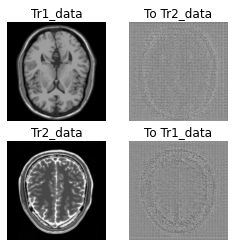

In [27]:
to_tr2_data = generator_g(sample_tr1_data)
to_tr1_data = generator_f(sample_tr2_data)

plt.figure(figsize=(4,4))

imgs = [sample_tr1_data, to_tr2_data, sample_tr2_data, to_tr1_data]
title = ['Tr1_data', 'To Tr2_data', 'Tr2_data', 'To Tr1_data']

for i in range(len(imgs)):
  plt.subplot(2, 2, i+1)
  plt.title(title[i])
  plt.imshow(imgs[i][0].numpy()[:,:,0], cmap='gray')
  plt.axis('off')
plt.show()

#### Declare Loss as Binary Cross Entropy
Since Our Discriminator is a classifier (True/False)

In [28]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Discriminator Loss
It consists of two types of losses
*    Loss on Real Data
*    Loss on Fake Data

In [29]:
def discriminator_loss(real, generated):
  real_loss = loss_obj(tf.ones_like(real), real)
  generated_loss = loss_obj(tf.zeros_like(generated),generated)
  total_disc_loss = real_loss + generated_loss
  return total_disc_loss * 0.5 # mean of loss (value between (0-1))

#### Generator Loss
It has only one type of loss - Discriminator Loss on Generated data

In [30]:
def generator_loss(generated):
  return loss_obj(tf.ones_like(generated),generated)

#### Cycle Loss
When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.

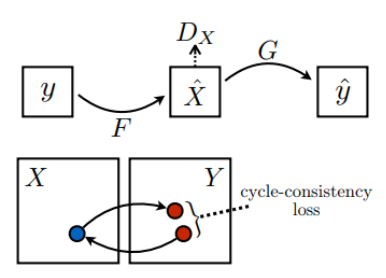

In [31]:
def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
  return 10.0 * loss1

#### Identity Loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here also we take L1 Loss between Input and Output Image.

In [32]:
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return 0.5 * loss

### Defining th Optimizer 
We use Adam Optimizer to update weights which is a good optimizer to achieve quick learning.

In [33]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [34]:
discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

#### We will run the model till 200 epochs

In [35]:
EPOCHS = 200

#### Checkpoint Initialization
Initialize checkpoints to save models

In [36]:
checkpoint_path = './Trained_Model'

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print('Latest checkpoint restored')

#### Function to show Images output by Generators while Training

In [37]:
def generate_images(model1, test_input1, model2, test_input2):
  prediction1 = model1(test_input1)
  prediction2 = model2(test_input2)
  plt.figure(figsize=(8,4))
  display_list = [test_input1[0], prediction1[0], test_input2[0],prediction2[0]]
  title = ['Input Tr1 Image', 'Predicted TR2 Image', 'Input Tr2 Image', 'Predicted Tr1 Image']
  for i in range(4):
    plt.subplot(1, 4, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i].numpy()[:,:,0], cmap='gray')
    plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

###Sequence of Training Flow

1.   Generate Fake Tr2 image and Cycled Tr1
2.   Generate Fake Tr1 and Cycled Tr1
3.   Generate Fake Images through G and F for Identity Loss.
4.   Calculate Discriminator Loss for Discriminator-X and Discriminator-Y on Fake Data for Generator Training.
5.   Calculate Generator Loss on Discriminator.
6.   Calculate Cycled Loss on Cycled Images from step 1 and 2.
7.   Calculate Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
8.   Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9.   Calculate the Gradients and update the weight and bias of models.



In [38]:
@tf.function
def train_step(real_x, real_y):
  # presistent is set to True because the tape is used more than
  # once to calculate the gradients
  with tf.GradientTape(persistent=True) as tape:
    # Generator G translates X -> Y
    # Generator Y translates Y -> X
    fake_y = generator_g(real_x, training=True)
    cycled_x = generator_f(fake_y, training=True)

    fake_x = generator_f(real_y, training=True)
    cycled_y = generator_g(fake_x, training=True)

    # same_x and same_y are used for identity loss.
    same_x = generator_f(real_x, training=True)
    same_y = generator_g(real_y, training=True)

    disc_real_x = discriminator_x(real_x, training=True)
    disc_real_y = discriminator_y(real_y, training=True)

    disc_fake_x = discriminator_x(fake_x, training=True)
    disc_fake_y = discriminator_y(fake_y, training=True)

    # calculate the loss
    gen_g_loss = generator_loss(disc_fake_y)
    gen_f_loss = generator_loss(disc_fake_x)

    total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

    # Total generator loss = BCE + cycle loss + identity loss
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    # Discriminator's Loss
    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)


  generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)

  
  discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
  discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

  # Apply the gradients to the optimizer
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
  generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))

  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))


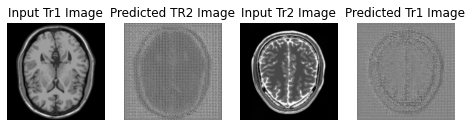

Saving checkpoint for epoch 1 at ./Trained_Model/ckpt-1


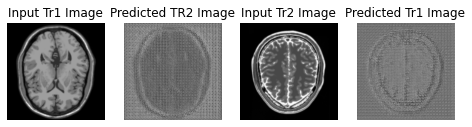

Saving checkpoint for epoch 2 at ./Trained_Model/ckpt-2


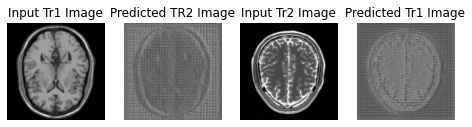

Saving checkpoint for epoch 3 at ./Trained_Model/ckpt-3


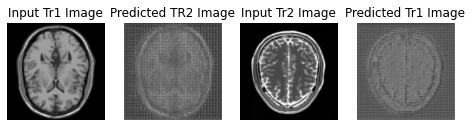

Saving checkpoint for epoch 4 at ./Trained_Model/ckpt-4


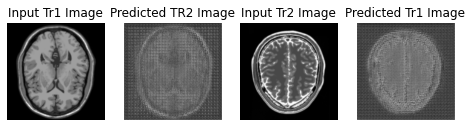

Saving checkpoint for epoch 5 at ./Trained_Model/ckpt-5


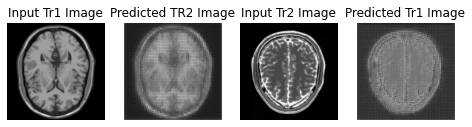

Saving checkpoint for epoch 6 at ./Trained_Model/ckpt-6


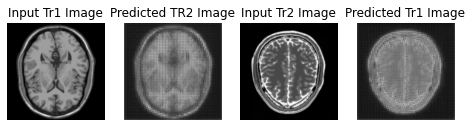

Saving checkpoint for epoch 7 at ./Trained_Model/ckpt-7


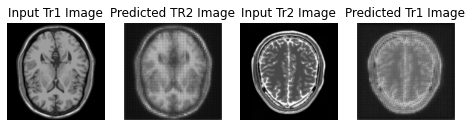

Saving checkpoint for epoch 8 at ./Trained_Model/ckpt-8


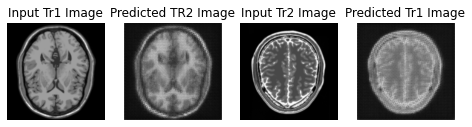

Saving checkpoint for epoch 9 at ./Trained_Model/ckpt-9


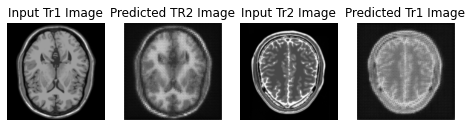

Saving checkpoint for epoch 10 at ./Trained_Model/ckpt-10


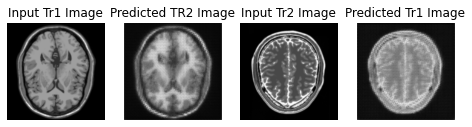

Saving checkpoint for epoch 11 at ./Trained_Model/ckpt-11


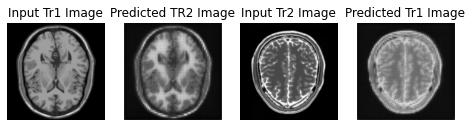

Saving checkpoint for epoch 12 at ./Trained_Model/ckpt-12


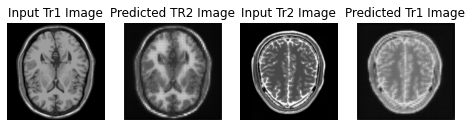

Saving checkpoint for epoch 13 at ./Trained_Model/ckpt-13


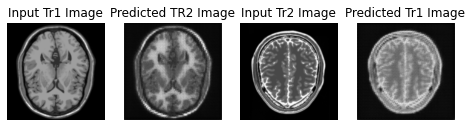

Saving checkpoint for epoch 14 at ./Trained_Model/ckpt-14


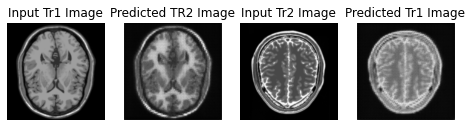

Saving checkpoint for epoch 15 at ./Trained_Model/ckpt-15


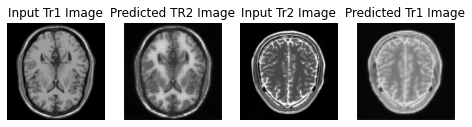

Saving checkpoint for epoch 16 at ./Trained_Model/ckpt-16


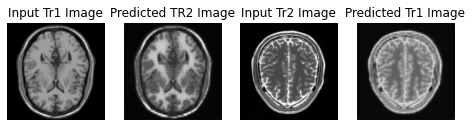

Saving checkpoint for epoch 17 at ./Trained_Model/ckpt-17


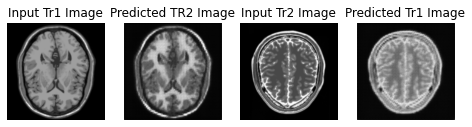

Saving checkpoint for epoch 18 at ./Trained_Model/ckpt-18


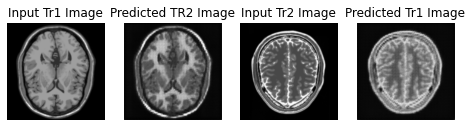

Saving checkpoint for epoch 19 at ./Trained_Model/ckpt-19


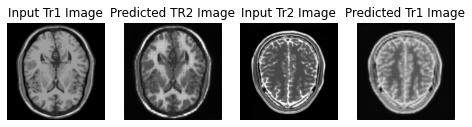

Saving checkpoint for epoch 20 at ./Trained_Model/ckpt-20


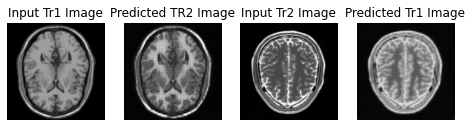

Saving checkpoint for epoch 21 at ./Trained_Model/ckpt-21


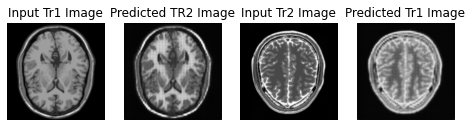

Saving checkpoint for epoch 22 at ./Trained_Model/ckpt-22


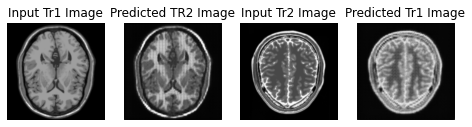

Saving checkpoint for epoch 23 at ./Trained_Model/ckpt-23


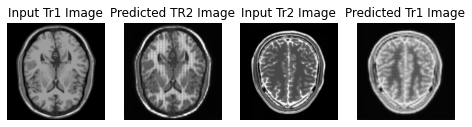

Saving checkpoint for epoch 24 at ./Trained_Model/ckpt-24


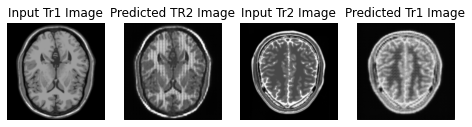

Saving checkpoint for epoch 25 at ./Trained_Model/ckpt-25


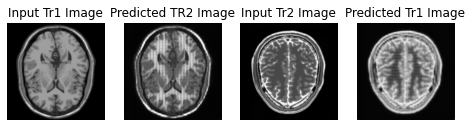

Saving checkpoint for epoch 26 at ./Trained_Model/ckpt-26


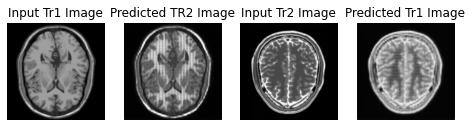

Saving checkpoint for epoch 27 at ./Trained_Model/ckpt-27


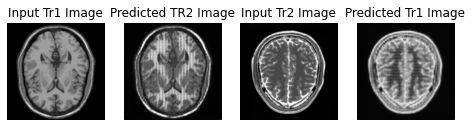

Saving checkpoint for epoch 28 at ./Trained_Model/ckpt-28


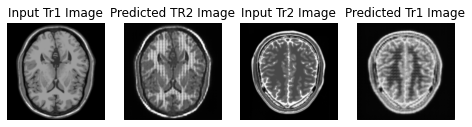

Saving checkpoint for epoch 29 at ./Trained_Model/ckpt-29


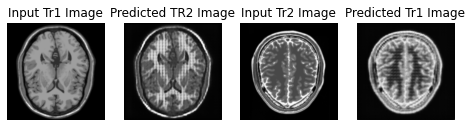

Saving checkpoint for epoch 30 at ./Trained_Model/ckpt-30


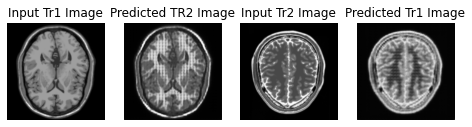

Saving checkpoint for epoch 31 at ./Trained_Model/ckpt-31


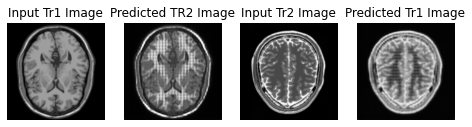

Saving checkpoint for epoch 32 at ./Trained_Model/ckpt-32


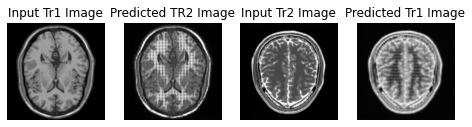

Saving checkpoint for epoch 33 at ./Trained_Model/ckpt-33


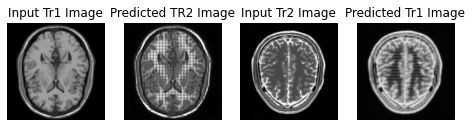

Saving checkpoint for epoch 34 at ./Trained_Model/ckpt-34


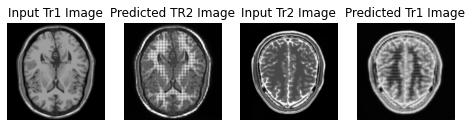

Saving checkpoint for epoch 35 at ./Trained_Model/ckpt-35


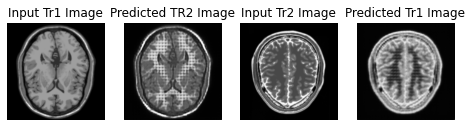

Saving checkpoint for epoch 36 at ./Trained_Model/ckpt-36


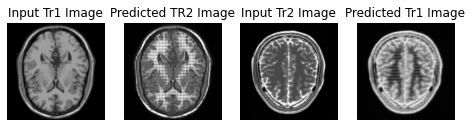

Saving checkpoint for epoch 37 at ./Trained_Model/ckpt-37


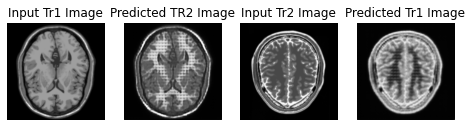

Saving checkpoint for epoch 38 at ./Trained_Model/ckpt-38


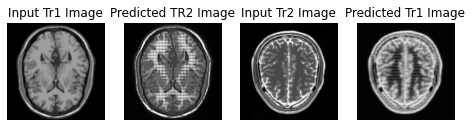

Saving checkpoint for epoch 39 at ./Trained_Model/ckpt-39


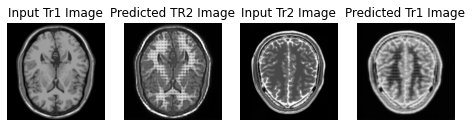

Saving checkpoint for epoch 40 at ./Trained_Model/ckpt-40


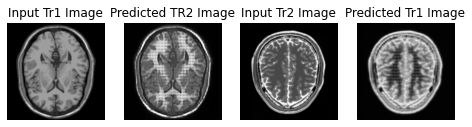

Saving checkpoint for epoch 41 at ./Trained_Model/ckpt-41


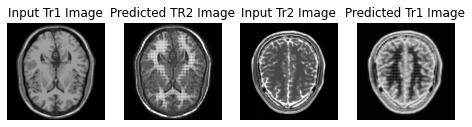

Saving checkpoint for epoch 42 at ./Trained_Model/ckpt-42


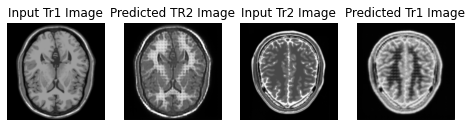

Saving checkpoint for epoch 43 at ./Trained_Model/ckpt-43


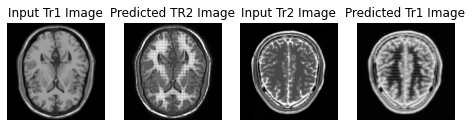

Saving checkpoint for epoch 44 at ./Trained_Model/ckpt-44


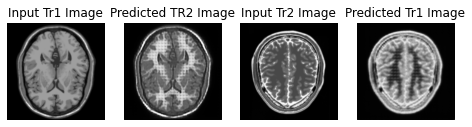

Saving checkpoint for epoch 45 at ./Trained_Model/ckpt-45


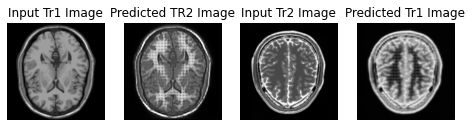

Saving checkpoint for epoch 46 at ./Trained_Model/ckpt-46


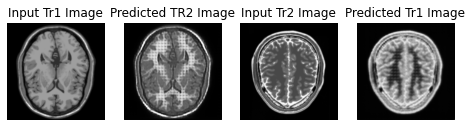

Saving checkpoint for epoch 47 at ./Trained_Model/ckpt-47


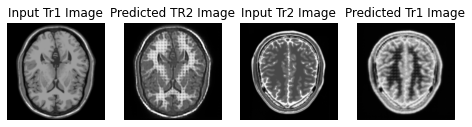

Saving checkpoint for epoch 48 at ./Trained_Model/ckpt-48


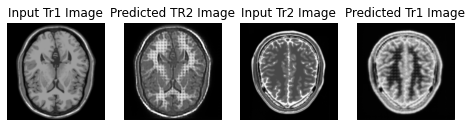

Saving checkpoint for epoch 49 at ./Trained_Model/ckpt-49


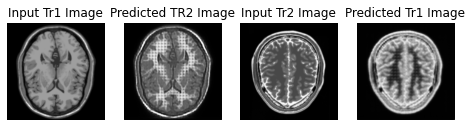

Saving checkpoint for epoch 50 at ./Trained_Model/ckpt-50


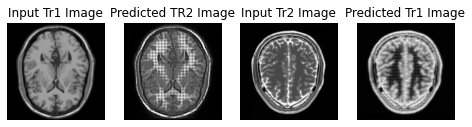

Saving checkpoint for epoch 51 at ./Trained_Model/ckpt-51


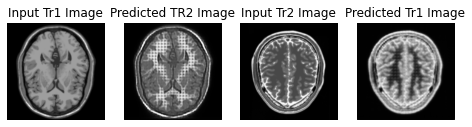

Saving checkpoint for epoch 52 at ./Trained_Model/ckpt-52


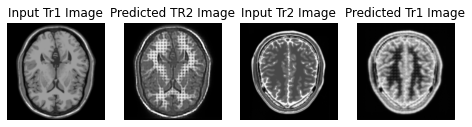

Saving checkpoint for epoch 53 at ./Trained_Model/ckpt-53


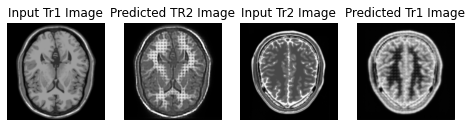

Saving checkpoint for epoch 54 at ./Trained_Model/ckpt-54


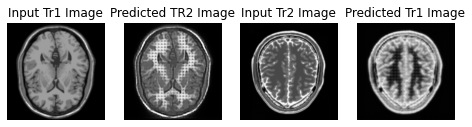

Saving checkpoint for epoch 55 at ./Trained_Model/ckpt-55


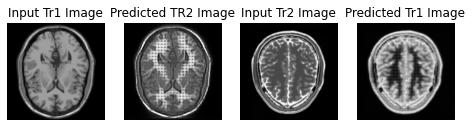

Saving checkpoint for epoch 56 at ./Trained_Model/ckpt-56


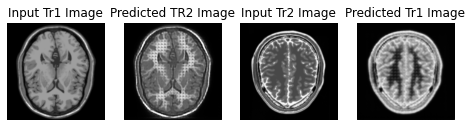

Saving checkpoint for epoch 57 at ./Trained_Model/ckpt-57


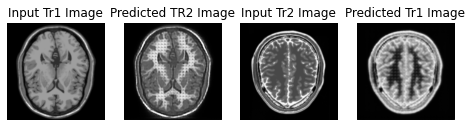

Saving checkpoint for epoch 58 at ./Trained_Model/ckpt-58


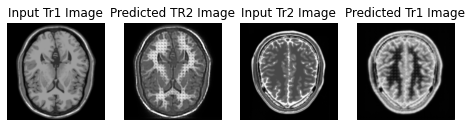

Saving checkpoint for epoch 59 at ./Trained_Model/ckpt-59


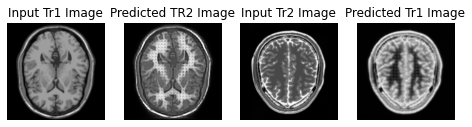

Saving checkpoint for epoch 60 at ./Trained_Model/ckpt-60


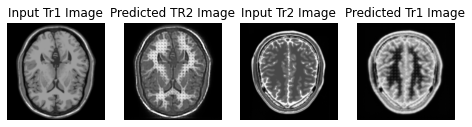

Saving checkpoint for epoch 61 at ./Trained_Model/ckpt-61


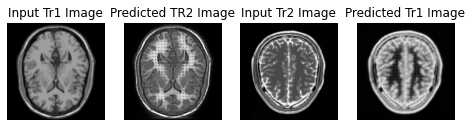

Saving checkpoint for epoch 62 at ./Trained_Model/ckpt-62


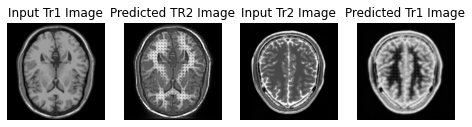

Saving checkpoint for epoch 63 at ./Trained_Model/ckpt-63


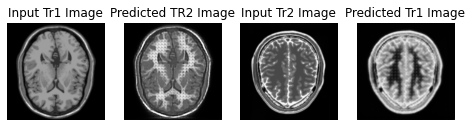

Saving checkpoint for epoch 64 at ./Trained_Model/ckpt-64


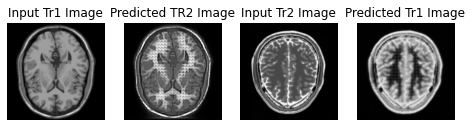

Saving checkpoint for epoch 65 at ./Trained_Model/ckpt-65


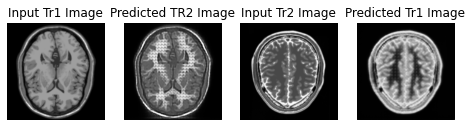

Saving checkpoint for epoch 66 at ./Trained_Model/ckpt-66


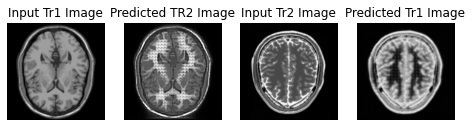

Saving checkpoint for epoch 67 at ./Trained_Model/ckpt-67


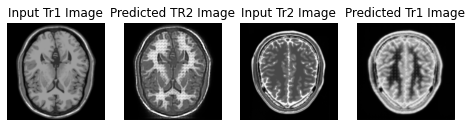

Saving checkpoint for epoch 68 at ./Trained_Model/ckpt-68


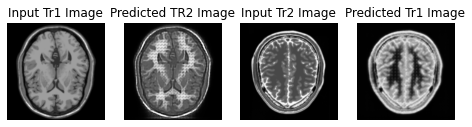

Saving checkpoint for epoch 69 at ./Trained_Model/ckpt-69


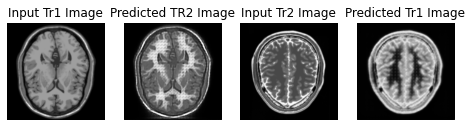

Saving checkpoint for epoch 70 at ./Trained_Model/ckpt-70


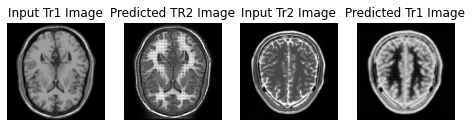

Saving checkpoint for epoch 71 at ./Trained_Model/ckpt-71


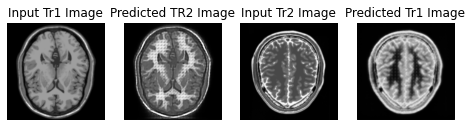

Saving checkpoint for epoch 72 at ./Trained_Model/ckpt-72


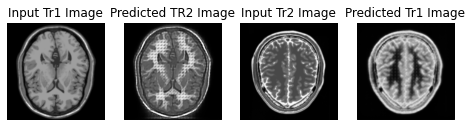

Saving checkpoint for epoch 73 at ./Trained_Model/ckpt-73


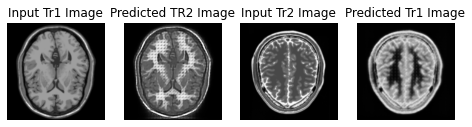

Saving checkpoint for epoch 74 at ./Trained_Model/ckpt-74


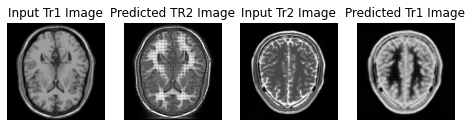

Saving checkpoint for epoch 75 at ./Trained_Model/ckpt-75


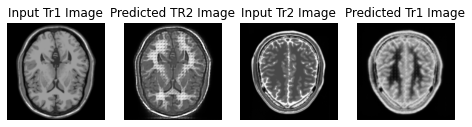

Saving checkpoint for epoch 76 at ./Trained_Model/ckpt-76


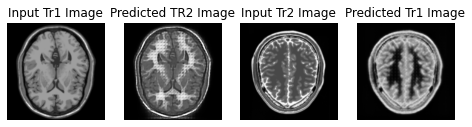

Saving checkpoint for epoch 77 at ./Trained_Model/ckpt-77


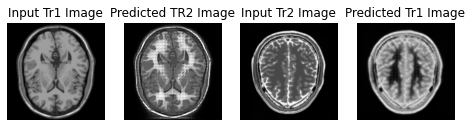

Saving checkpoint for epoch 78 at ./Trained_Model/ckpt-78


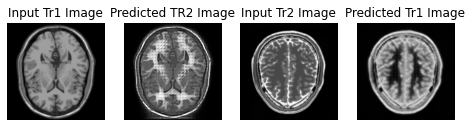

Saving checkpoint for epoch 79 at ./Trained_Model/ckpt-79


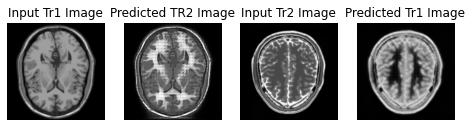

Saving checkpoint for epoch 80 at ./Trained_Model/ckpt-80


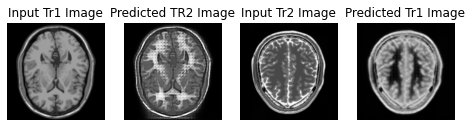

Saving checkpoint for epoch 81 at ./Trained_Model/ckpt-81


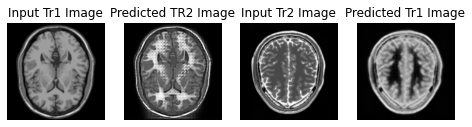

Saving checkpoint for epoch 82 at ./Trained_Model/ckpt-82


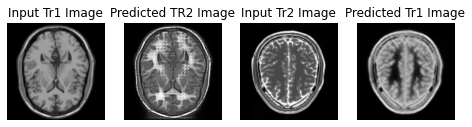

Saving checkpoint for epoch 83 at ./Trained_Model/ckpt-83


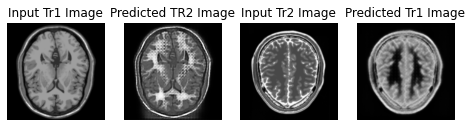

Saving checkpoint for epoch 84 at ./Trained_Model/ckpt-84


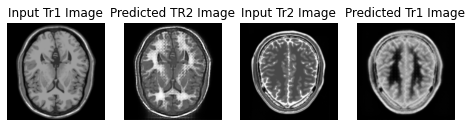

Saving checkpoint for epoch 85 at ./Trained_Model/ckpt-85


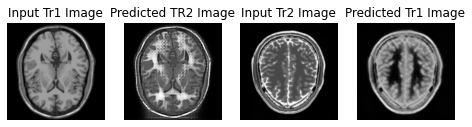

Saving checkpoint for epoch 86 at ./Trained_Model/ckpt-86


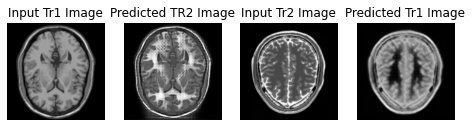

Saving checkpoint for epoch 87 at ./Trained_Model/ckpt-87


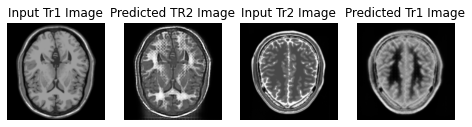

Saving checkpoint for epoch 88 at ./Trained_Model/ckpt-88


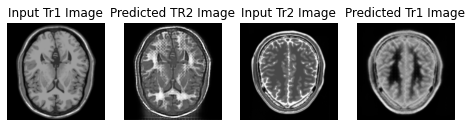

Saving checkpoint for epoch 89 at ./Trained_Model/ckpt-89


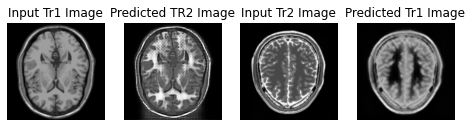

Saving checkpoint for epoch 90 at ./Trained_Model/ckpt-90


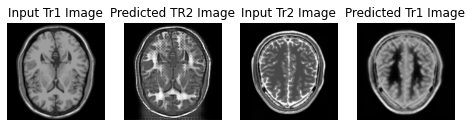

Saving checkpoint for epoch 91 at ./Trained_Model/ckpt-91


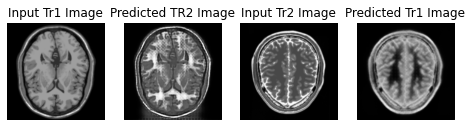

Saving checkpoint for epoch 92 at ./Trained_Model/ckpt-92


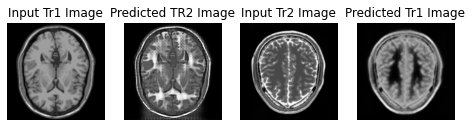

Saving checkpoint for epoch 93 at ./Trained_Model/ckpt-93


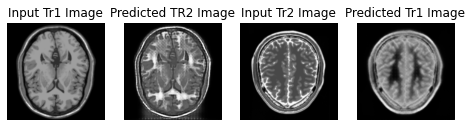

Saving checkpoint for epoch 94 at ./Trained_Model/ckpt-94


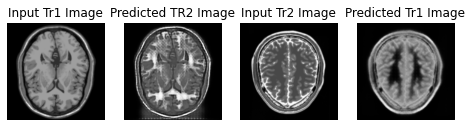

Saving checkpoint for epoch 95 at ./Trained_Model/ckpt-95


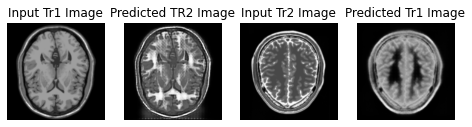

Saving checkpoint for epoch 96 at ./Trained_Model/ckpt-96


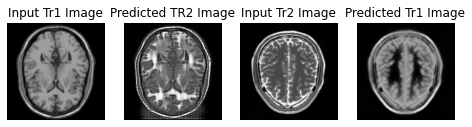

Saving checkpoint for epoch 97 at ./Trained_Model/ckpt-97


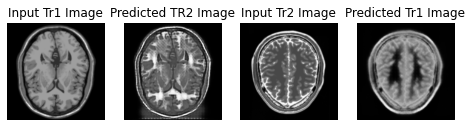

Saving checkpoint for epoch 98 at ./Trained_Model/ckpt-98


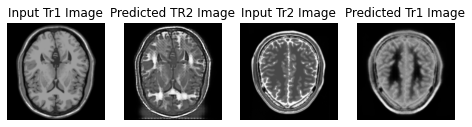

Saving checkpoint for epoch 99 at ./Trained_Model/ckpt-99


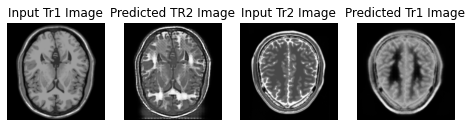

Saving checkpoint for epoch 100 at ./Trained_Model/ckpt-100


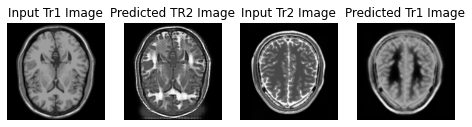

Saving checkpoint for epoch 101 at ./Trained_Model/ckpt-101


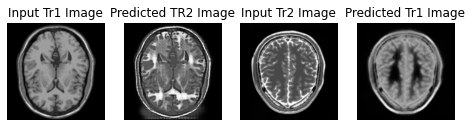

Saving checkpoint for epoch 102 at ./Trained_Model/ckpt-102


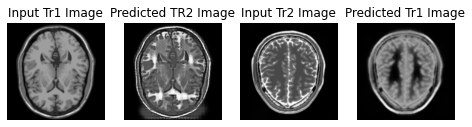

Saving checkpoint for epoch 103 at ./Trained_Model/ckpt-103


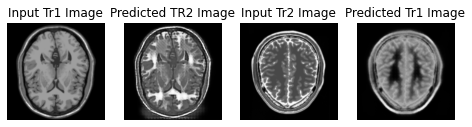

Saving checkpoint for epoch 104 at ./Trained_Model/ckpt-104


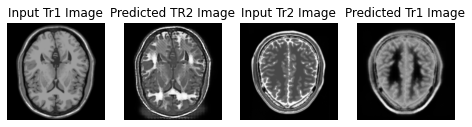

Saving checkpoint for epoch 105 at ./Trained_Model/ckpt-105


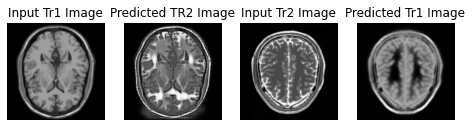

Saving checkpoint for epoch 106 at ./Trained_Model/ckpt-106


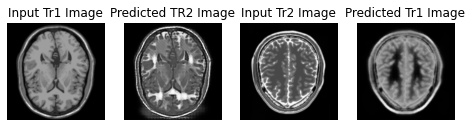

Saving checkpoint for epoch 107 at ./Trained_Model/ckpt-107


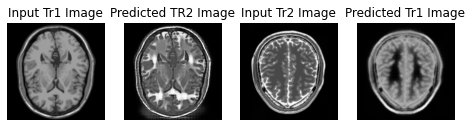

Saving checkpoint for epoch 108 at ./Trained_Model/ckpt-108


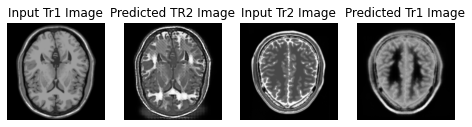

Saving checkpoint for epoch 109 at ./Trained_Model/ckpt-109


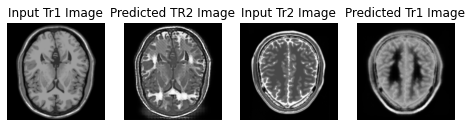

Saving checkpoint for epoch 110 at ./Trained_Model/ckpt-110


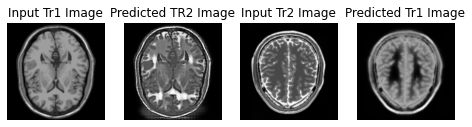

Saving checkpoint for epoch 111 at ./Trained_Model/ckpt-111


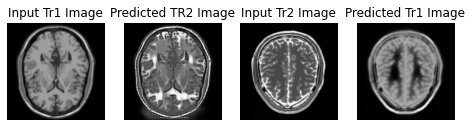

Saving checkpoint for epoch 112 at ./Trained_Model/ckpt-112


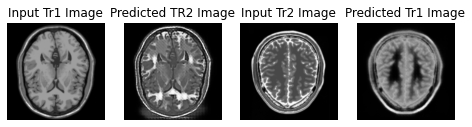

Saving checkpoint for epoch 113 at ./Trained_Model/ckpt-113


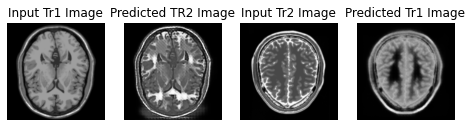

Saving checkpoint for epoch 114 at ./Trained_Model/ckpt-114


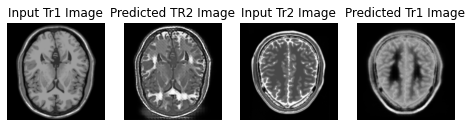

Saving checkpoint for epoch 115 at ./Trained_Model/ckpt-115


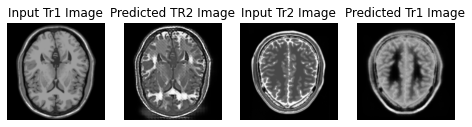

Saving checkpoint for epoch 116 at ./Trained_Model/ckpt-116


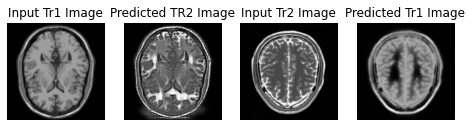

Saving checkpoint for epoch 117 at ./Trained_Model/ckpt-117


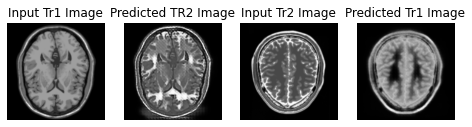

Saving checkpoint for epoch 118 at ./Trained_Model/ckpt-118


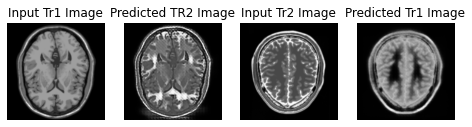

Saving checkpoint for epoch 119 at ./Trained_Model/ckpt-119


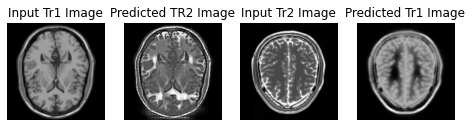

Saving checkpoint for epoch 120 at ./Trained_Model/ckpt-120


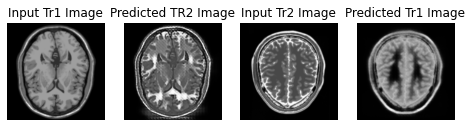

Saving checkpoint for epoch 121 at ./Trained_Model/ckpt-121


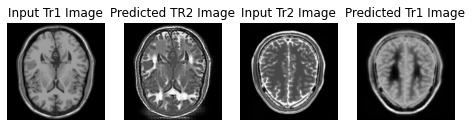

Saving checkpoint for epoch 122 at ./Trained_Model/ckpt-122


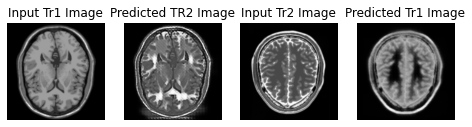

Saving checkpoint for epoch 123 at ./Trained_Model/ckpt-123


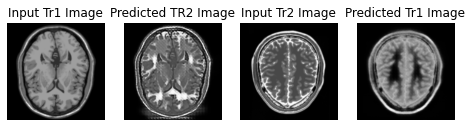

Saving checkpoint for epoch 124 at ./Trained_Model/ckpt-124


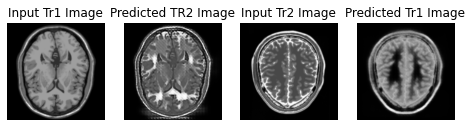

Saving checkpoint for epoch 125 at ./Trained_Model/ckpt-125


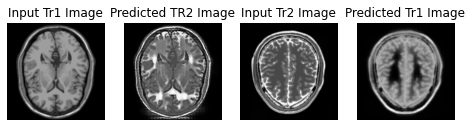

Saving checkpoint for epoch 126 at ./Trained_Model/ckpt-126


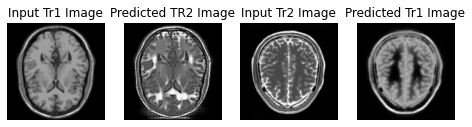

Saving checkpoint for epoch 127 at ./Trained_Model/ckpt-127


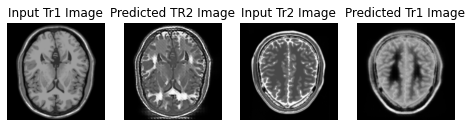

Saving checkpoint for epoch 128 at ./Trained_Model/ckpt-128


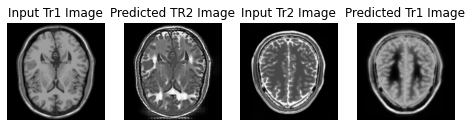

Saving checkpoint for epoch 129 at ./Trained_Model/ckpt-129


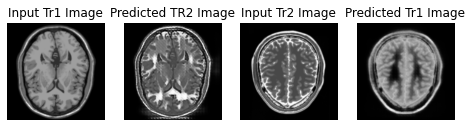

Saving checkpoint for epoch 130 at ./Trained_Model/ckpt-130


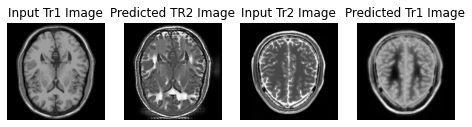

Saving checkpoint for epoch 131 at ./Trained_Model/ckpt-131


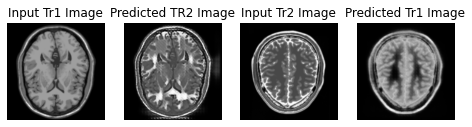

Saving checkpoint for epoch 132 at ./Trained_Model/ckpt-132


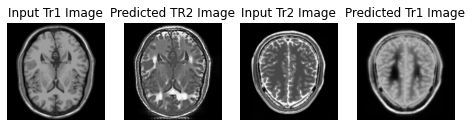

Saving checkpoint for epoch 133 at ./Trained_Model/ckpt-133


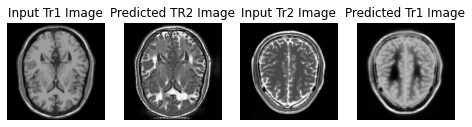

Saving checkpoint for epoch 134 at ./Trained_Model/ckpt-134


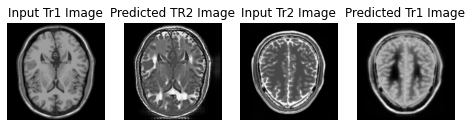

Saving checkpoint for epoch 135 at ./Trained_Model/ckpt-135


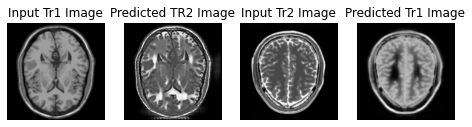

Saving checkpoint for epoch 136 at ./Trained_Model/ckpt-136


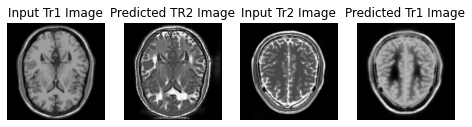

Saving checkpoint for epoch 137 at ./Trained_Model/ckpt-137


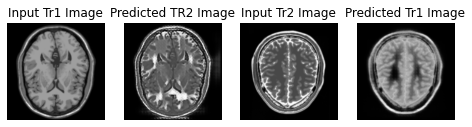

Saving checkpoint for epoch 138 at ./Trained_Model/ckpt-138


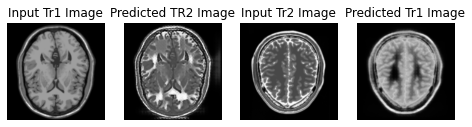

Saving checkpoint for epoch 139 at ./Trained_Model/ckpt-139


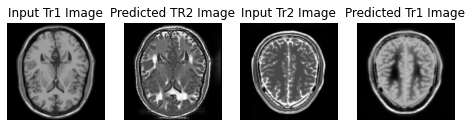

Saving checkpoint for epoch 140 at ./Trained_Model/ckpt-140


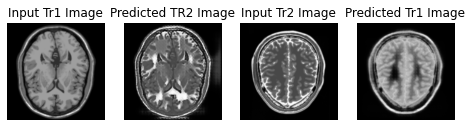

Saving checkpoint for epoch 141 at ./Trained_Model/ckpt-141


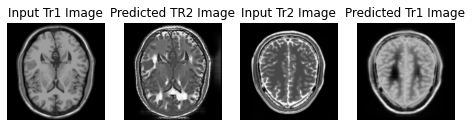

Saving checkpoint for epoch 142 at ./Trained_Model/ckpt-142


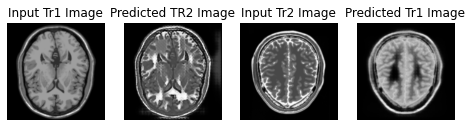

Saving checkpoint for epoch 143 at ./Trained_Model/ckpt-143


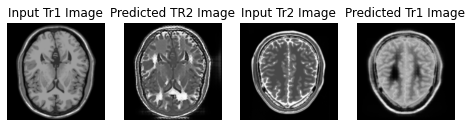

Saving checkpoint for epoch 144 at ./Trained_Model/ckpt-144


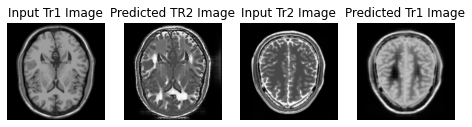

Saving checkpoint for epoch 145 at ./Trained_Model/ckpt-145


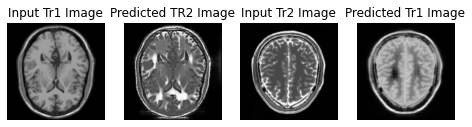

Saving checkpoint for epoch 146 at ./Trained_Model/ckpt-146


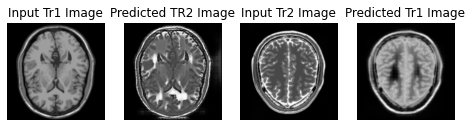

Saving checkpoint for epoch 147 at ./Trained_Model/ckpt-147


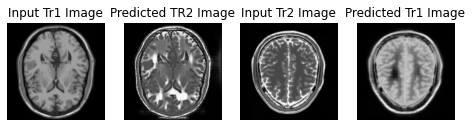

Saving checkpoint for epoch 148 at ./Trained_Model/ckpt-148


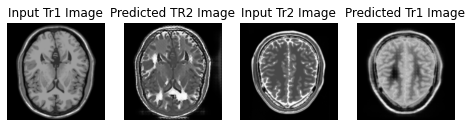

Saving checkpoint for epoch 149 at ./Trained_Model/ckpt-149


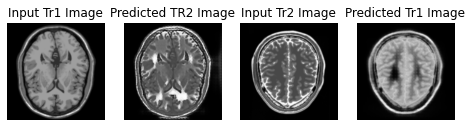

Saving checkpoint for epoch 150 at ./Trained_Model/ckpt-150


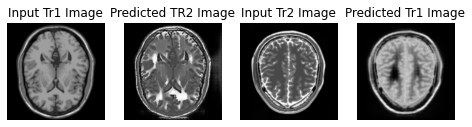

Saving checkpoint for epoch 151 at ./Trained_Model/ckpt-151


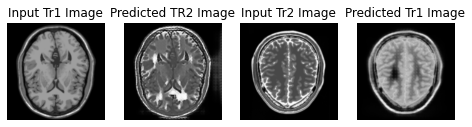

Saving checkpoint for epoch 152 at ./Trained_Model/ckpt-152


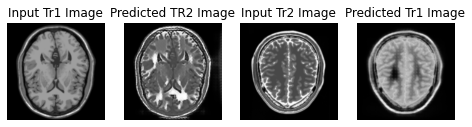

Saving checkpoint for epoch 153 at ./Trained_Model/ckpt-153


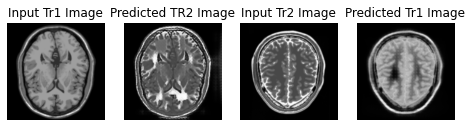

Saving checkpoint for epoch 154 at ./Trained_Model/ckpt-154


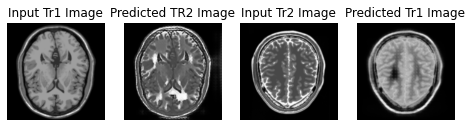

Saving checkpoint for epoch 155 at ./Trained_Model/ckpt-155


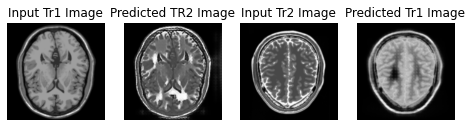

Saving checkpoint for epoch 156 at ./Trained_Model/ckpt-156


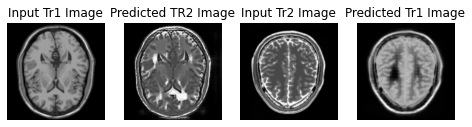

Saving checkpoint for epoch 157 at ./Trained_Model/ckpt-157


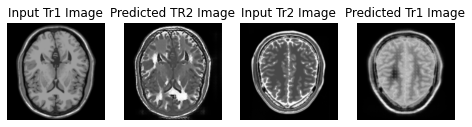

Saving checkpoint for epoch 158 at ./Trained_Model/ckpt-158


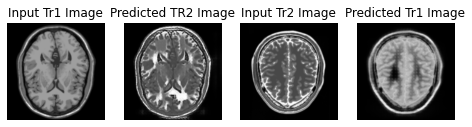

Saving checkpoint for epoch 159 at ./Trained_Model/ckpt-159


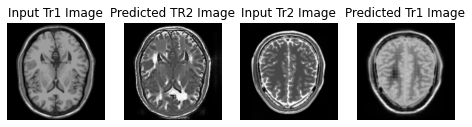

Saving checkpoint for epoch 160 at ./Trained_Model/ckpt-160


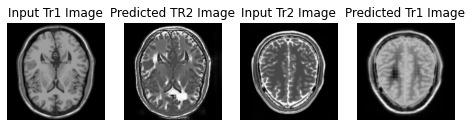

Saving checkpoint for epoch 161 at ./Trained_Model/ckpt-161


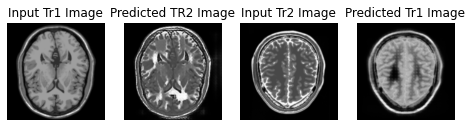

Saving checkpoint for epoch 162 at ./Trained_Model/ckpt-162


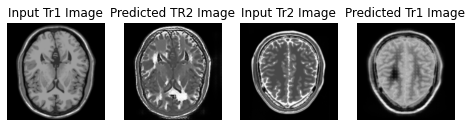

Saving checkpoint for epoch 163 at ./Trained_Model/ckpt-163


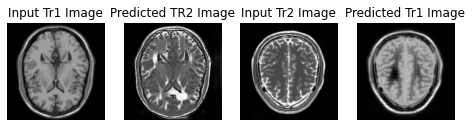

Saving checkpoint for epoch 164 at ./Trained_Model/ckpt-164


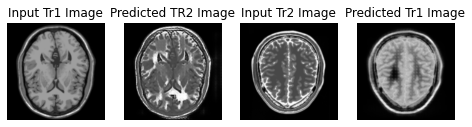

Saving checkpoint for epoch 165 at ./Trained_Model/ckpt-165


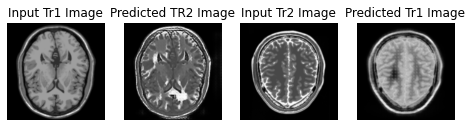

Saving checkpoint for epoch 166 at ./Trained_Model/ckpt-166


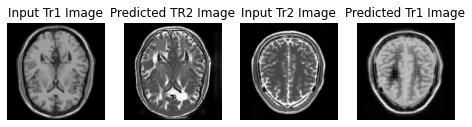

Saving checkpoint for epoch 167 at ./Trained_Model/ckpt-167


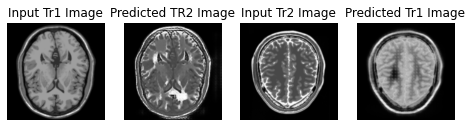

Saving checkpoint for epoch 168 at ./Trained_Model/ckpt-168


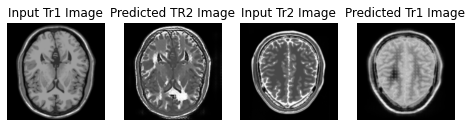

Saving checkpoint for epoch 169 at ./Trained_Model/ckpt-169


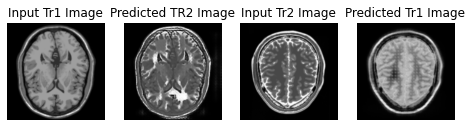

Saving checkpoint for epoch 170 at ./Trained_Model/ckpt-170


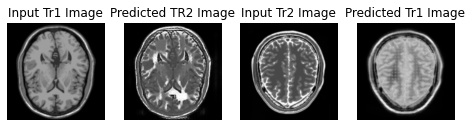

Saving checkpoint for epoch 171 at ./Trained_Model/ckpt-171


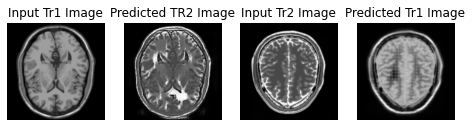

Saving checkpoint for epoch 172 at ./Trained_Model/ckpt-172


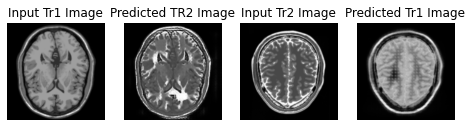

Saving checkpoint for epoch 173 at ./Trained_Model/ckpt-173


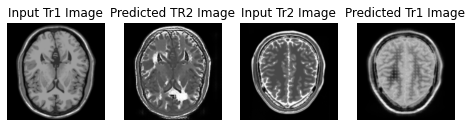

Saving checkpoint for epoch 174 at ./Trained_Model/ckpt-174


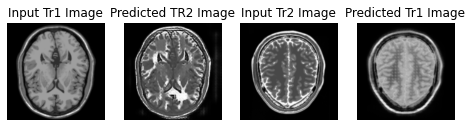

Saving checkpoint for epoch 175 at ./Trained_Model/ckpt-175


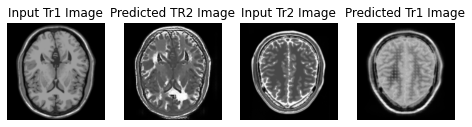

Saving checkpoint for epoch 176 at ./Trained_Model/ckpt-176


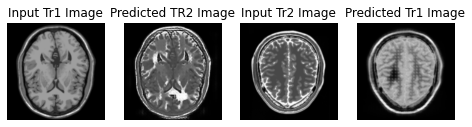

Saving checkpoint for epoch 177 at ./Trained_Model/ckpt-177


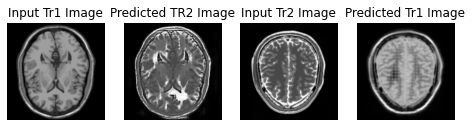

Saving checkpoint for epoch 178 at ./Trained_Model/ckpt-178


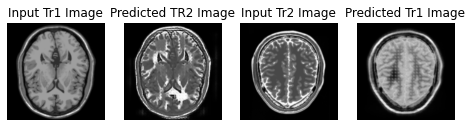

Saving checkpoint for epoch 179 at ./Trained_Model/ckpt-179


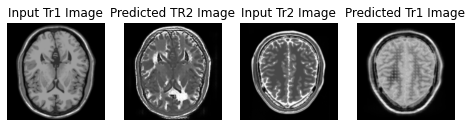

Saving checkpoint for epoch 180 at ./Trained_Model/ckpt-180


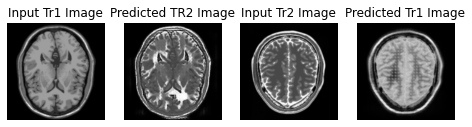

Saving checkpoint for epoch 181 at ./Trained_Model/ckpt-181


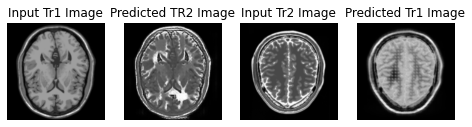

Saving checkpoint for epoch 182 at ./Trained_Model/ckpt-182


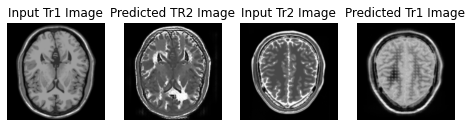

Saving checkpoint for epoch 183 at ./Trained_Model/ckpt-183


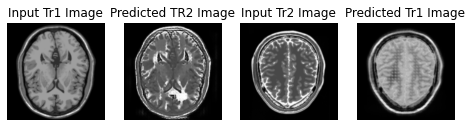

Saving checkpoint for epoch 184 at ./Trained_Model/ckpt-184


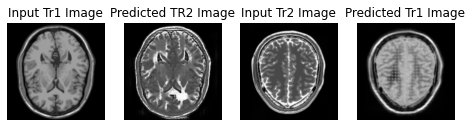

Saving checkpoint for epoch 185 at ./Trained_Model/ckpt-185


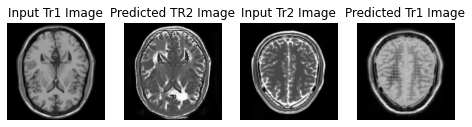

Saving checkpoint for epoch 186 at ./Trained_Model/ckpt-186


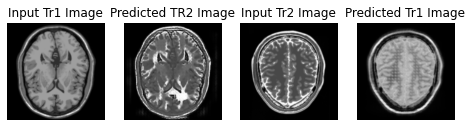

Saving checkpoint for epoch 187 at ./Trained_Model/ckpt-187


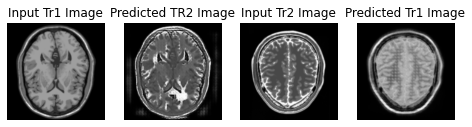

Saving checkpoint for epoch 188 at ./Trained_Model/ckpt-188


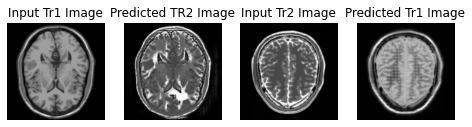

Saving checkpoint for epoch 189 at ./Trained_Model/ckpt-189


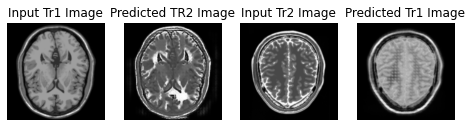

Saving checkpoint for epoch 190 at ./Trained_Model/ckpt-190


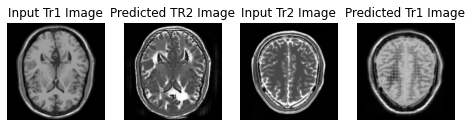

Saving checkpoint for epoch 191 at ./Trained_Model/ckpt-191


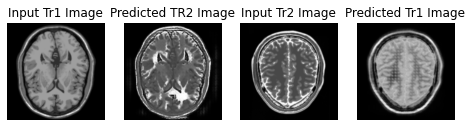

Saving checkpoint for epoch 192 at ./Trained_Model/ckpt-192


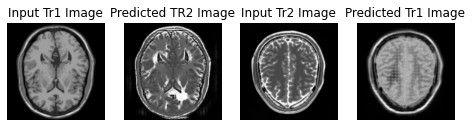

Saving checkpoint for epoch 193 at ./Trained_Model/ckpt-193


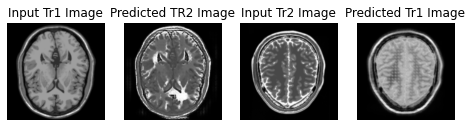

Saving checkpoint for epoch 194 at ./Trained_Model/ckpt-194


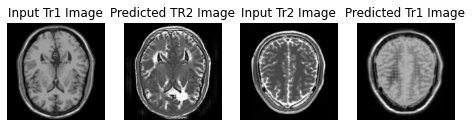

Saving checkpoint for epoch 195 at ./Trained_Model/ckpt-195


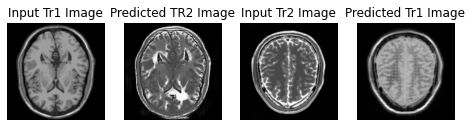

Saving checkpoint for epoch 196 at ./Trained_Model/ckpt-196


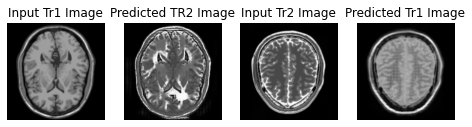

Saving checkpoint for epoch 197 at ./Trained_Model/ckpt-197


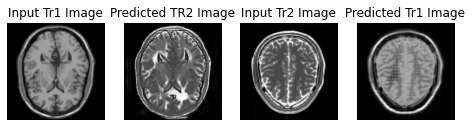

Saving checkpoint for epoch 198 at ./Trained_Model/ckpt-198


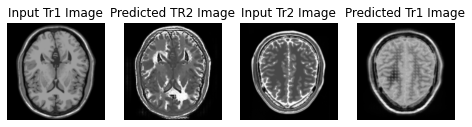

Saving checkpoint for epoch 199 at ./Trained_Model/ckpt-199


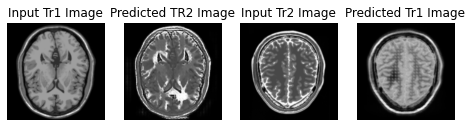

Saving checkpoint for epoch 200 at ./Trained_Model/ckpt-200


In [39]:
for epoch in range(1, EPOCHS+1):
  for image_x, image_y in tf.data.Dataset.zip((image_tr1,image_tr2)):
    train_step(image_x, image_y)

  generate_images(generator_g, sample_tr1_data,generator_f,sample_tr2_data)
  ckpt_save_path = ckpt_manager.save()
  print('Saving checkpoint for epoch', epoch,'at',ckpt_save_path)
  

#### Embeddeding all image to create .gif image

In [40]:
anim_file = 'cyclegan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


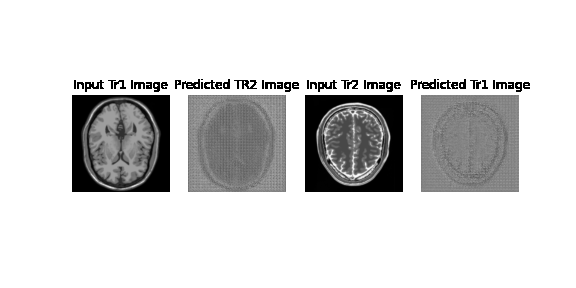

In [41]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)